# Cleaning

## Removing time and putting the words into a single text file.

In [1]:
import os
import re

folder_path = "Dataset"

timestamp_pattern = re.compile(r'\b\d{1,2}:\d{2}(:\d{2})?\b')

for root, dirs, files in os.walk(folder_path):
    if "cleaned" in root.split(os.sep):
        continue

    for filename in files:
        if filename.endswith(".txt"):
            file_path = os.path.join(root, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                text = file.read()

            cleaned_text = re.sub(timestamp_pattern, '', text)  
            cleaned_text = ' '.join(cleaned_text.split()) 

            save_path = os.path.join(os.path.dirname(root), "cleaned")
            os.makedirs(save_path, exist_ok=True)

            with open(os.path.join(save_path, filename), 'w', encoding='utf-8') as file:
                file.write(cleaned_text)


---
# Preproccessing

## Tokenization

In [2]:
import nltk
import json
from nltk.tokenize import *

folder_path = "Dataset"
data = {}

for root, dirs, files in os.walk(folder_path):
    if "raw_transcripts" in root.split(os.sep):
        continue
    for filename in files:
        if filename.endswith(".txt"):
            file_path = os.path.join(root, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                text = file.read()
                tokens = nltk.tokenize.wordpunct_tokenize(text)
                data[filename] = {
                    "tokens": [],
                    "filteredTokens": [],
                    "fullText": [],
                    "sentiment": [],
                    "category": [],
                    "channelName": []
                }
                data[filename]["tokens"].extend(tokens)
                data[filename]["fullText"].append(text)
        if filename.endswith(".json"):
            file_path = os.path.join(root, filename)
            with open(file_path, 'r', encoding='utf-8') as file:
                temp = json.load(file)
                data[filename.replace(".json", ".txt")]["category"] = temp["category"]
                data[filename.replace(".json", ".txt")]["channelName"] = temp["name"]

## Stop Word filtering

In [3]:
import nltk
import string
import re
from nltk.corpus import stopwords

nltk.download("stopwords")

arabic_stopwords = set(stopwords.words("arabic"))

custom_stopwords = {
    "برضه", "بتاع", "تقول", "إنك", "الناس", "ماشي", "وأنا", "فاهم", "وكان", "عندي",
    "فا", "وكده", "طيب", "قلت", "تمام", "كانت", "كنت", "حد", "طبعا", "طب", "عندك",
    "كانت", "المكان", "بيقول", "حاجات", "يبقى", "مفيش", "الأول", "السؤال", "سؤال",
    "الحاجات", "علشان", "عارف", "فكرة", "خالص", "مثلا", "تبقي", "الموضوع", "دلوقتي",
    "مرة", "إحنا", "ليه", "إم", "جدا", "فعلا", "كتير", "أكتر", "بيقبى", "إزاي", "ال",
    "خلاص", "يقبى", "صح", "عايز", "تكون", "عشان", "يكون", "لأ", "بقى", "إللي", "إنت",
    "أوكي", "لازم", "زي", "حاجة", "بقي", "كده", "ممكن", "أه", "دي", "ده", "مش",
    "هاهاها", "يعني"
}

all_stopwords = arabic_stopwords.union(custom_stopwords)

def clean_word(word):
    return re.sub(r"[^\w\s]", "", word) 

for filename in data:
    cleaned_tokens = [clean_word(word) for word in data[filename]["tokens"]] 
    filtered_tokens = [word for word in cleaned_tokens if word and word not in all_stopwords]  
    
    data[filename]["filteredTokens"].extend(filtered_tokens)


---
# We will explore to what extent does semantics and category affect a podcast
## Analysis
### These are the most common words per podcast episode,This shows that there is a relation between the most common word and category of the podcast, For example Podcasts that are more focused towards dating has keywords like "بنات" and "رجال".

   ---------------------------------------- 0.0/299.9 kB ? eta -:--:--
   ---- ----------------------------------- 30.7/299.9 kB 1.3 MB/s eta 0:00:01
   ---------------- ----------------------- 122.9/299.9 kB 1.4 MB/s eta 0:00:01
   -------------------------------------- - 286.7/299.9 kB 2.2 MB/s eta 0:00:01
   ---------------------------------------- 299.9/299.9 kB 2.1 MB/s eta 0:00:00
   ---------------------------------------- 0.0/160.6 kB ? eta -:--:--
   ---------------------------------------- 160.6/160.6 kB 3.2 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


C:\Users\youssef\AppData\Local\Temp\ipykernel_19704\2213783104.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 5))


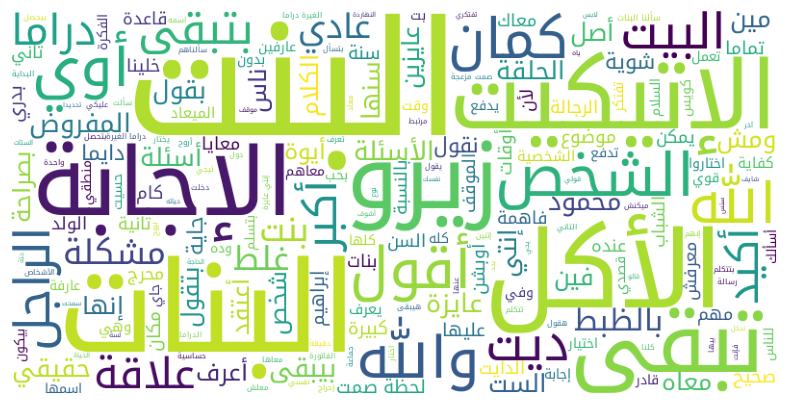

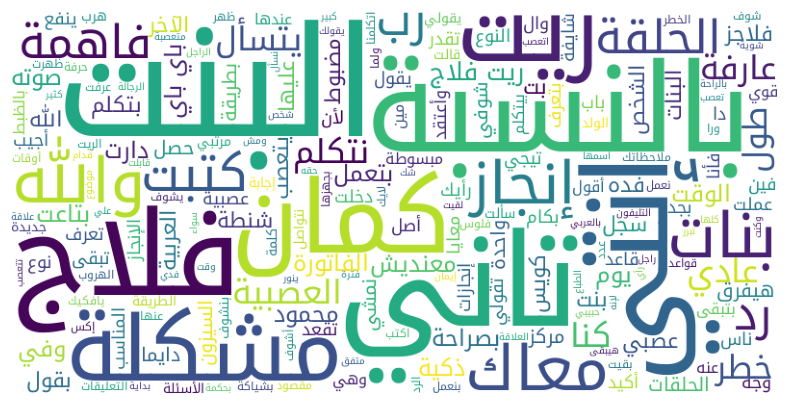

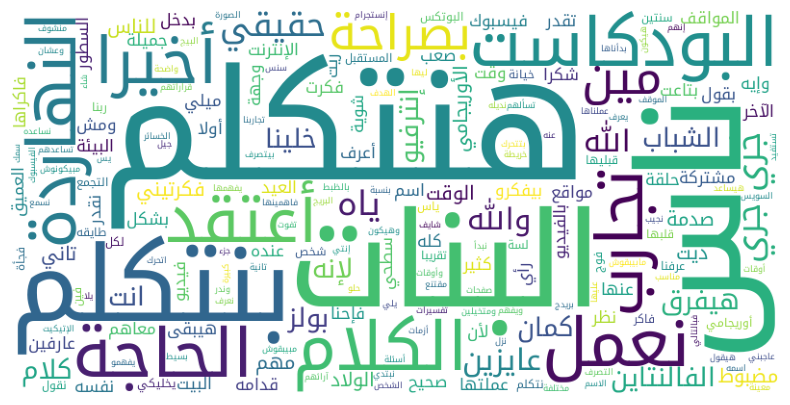

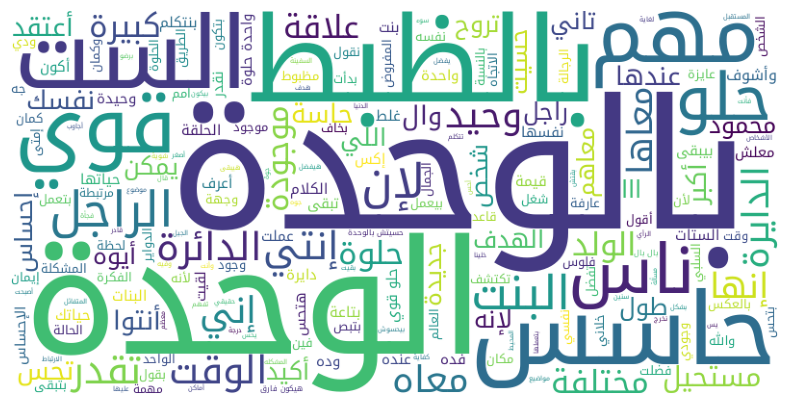

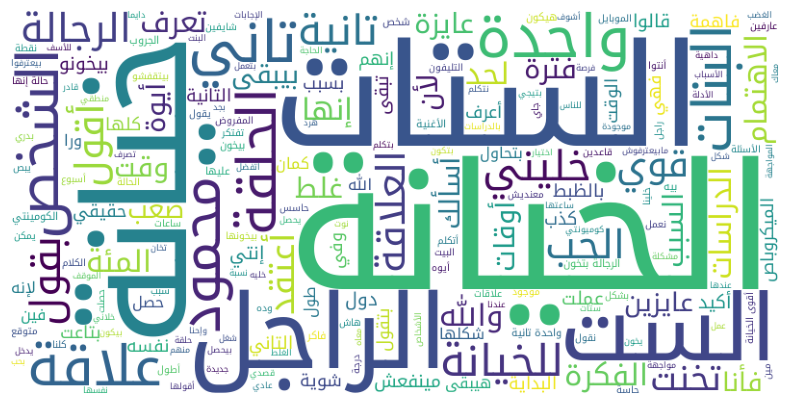

...

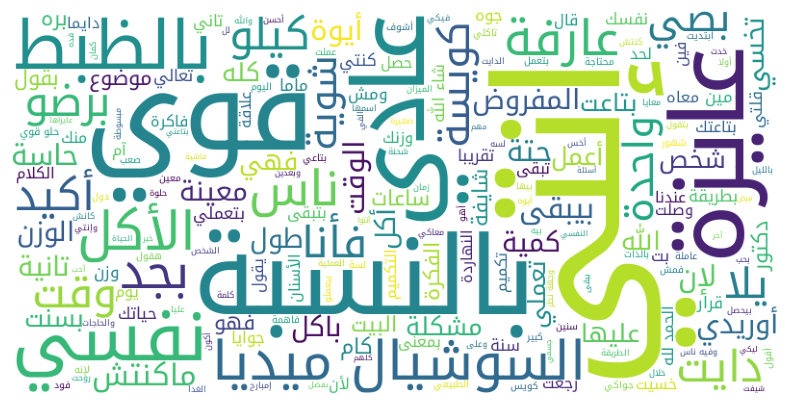

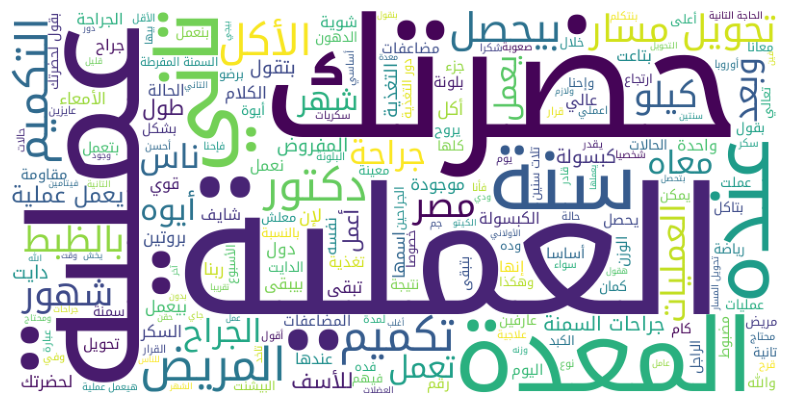

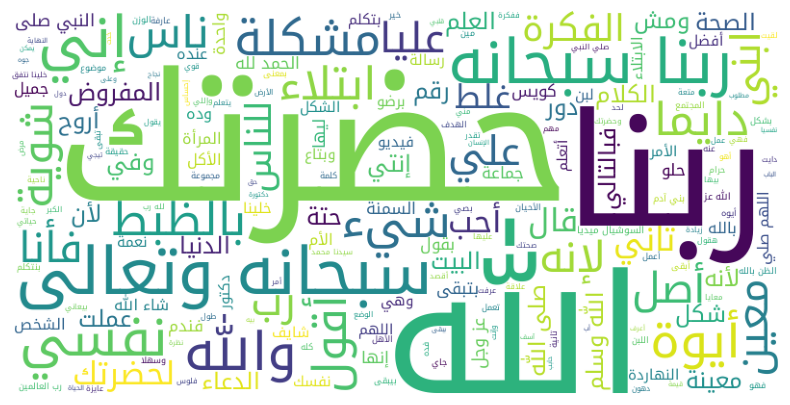

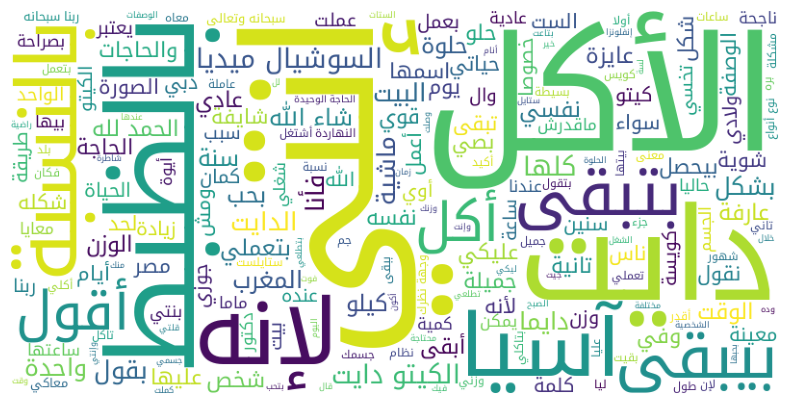

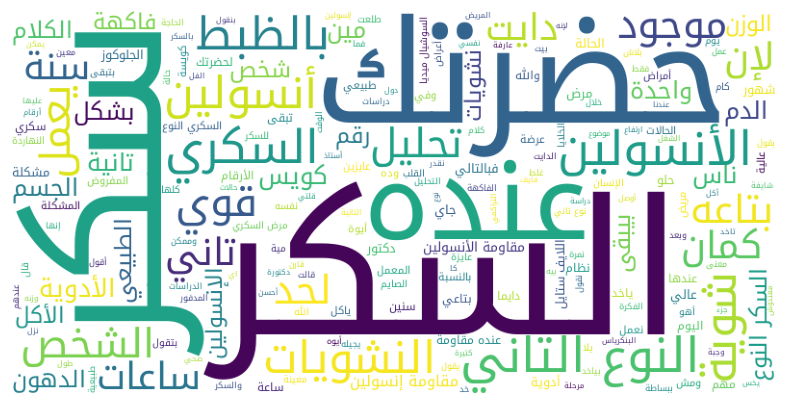

In [4]:
%pip install wordcloud matplotlib arabic-reshaper python-bidi
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import arabic_reshaper
from bidi.algorithm import get_display

font_path = "NotoKufiArabic-VariableFont_wght.ttf"

for filename in data:
    
    reshaped_text = arabic_reshaper.reshape(" ".join(data[filename]["filteredTokens"]))
    bidi_text = get_display(reshaped_text)

    wordcloud = WordCloud(
        width=800, height=400, font_path=font_path, background_color='white'
    ).generate(bidi_text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.savefig(f"wordcloud_{filename}.png")


In [5]:
from camel_tools.sentiment import SentimentAnalyzer

sa = SentimentAnalyzer.pretrained()
for filename in data:
    text = data[filename]["fullText"][0]
    sentiment = sa.predict(text)
    data[filename]["sentiment"] = sentiment
    print(f"{filename}: {sentiment}")

c:\Users\youssef\anaconda3\Lib\site-packages\torch\utils\_pytree.py:185: FutureWarning: optree is installed but the version is too old to support PyTorch Dynamo in C++ pytree. C++ pytree support is disabled. Please consider upgrading optree using `python3 -m pip install --upgrade 'optree>=0.13.0'`.
  warnings.warn(


؟(Date❤️) بودكاست أول مرة # 001 - إزاي نتصرف في أول مرة.txt: ['neutral']
ازاي تكتشف ال Red flags🚩.txt: ['neutral']
الحلقه صفر - بودكاست أول مرة - أول مرة اتقابلنا.txt: ['neutral']
الوحده_ و كيف تحولها الى قوة و سعاده.txt: ['positive']
بودكاست أول مرة # 002 - أول مرة اتخانت.txt: ['negative']
بودكاست أول مرة # 003 - اول مره تخسر صاحب عمرك.txt: ['neutral']
بودكاست أول مرة # 004 - ازاي نتصرف في الغربه؟.txt: ['negative']
بودكاست أول مرة # 006 - أول مرة تفكر في الجواز ؟.txt: ['negative']
بودكاست أول مرة # 007 - أول مرة ليك تقول لأ.txt: ['negative']
بودكاست أول مرة # 008 - حلقة العيد عن صناعة المحتوى🤩.txt: ['neutral']
بودكاست أول مرة # 009 - إول مرة تطلب مساعدة من حد؟.txt: ['neutral']
ازاي تفتح مطعم ؟ - من هو الشيف محمد صلاح ملاك اللحمة ؟ - Foodcast 5.txt: ['positive']
خسر في ٥ مطاعم وبدا من الصفر قبل نجاح مطعم ( Maine ماين ) - Foodcast 15.txt: ['positive']
خسرو اكثر من ٤ مليون و للاسباب ديه اوعى تفتح مطعم - Foodcast 17.txt: ['positive']
دكتور اسنان الصبح و فوودبلوجر بليل مع عمرو الهادي - Foo

In [ ]:
from collections import defaultdict
negativeCategoryCounter = defaultdict(int)

for filename in data:
    if data[filename]["sentiment"] == "negative":
        negativeCategoryCounter[data[filename]["category"]] += 1

In [7]:
import pandas as pd

import matplotlib.pyplot as plt

# Create a DataFrame to hold the sentiment counts
sentiment_data = []

for filename in data:
    sentiment = data[filename]["sentiment"]
    channel = data[filename]["channelName"]
    if isinstance(channel, list):
        channel = ', '.join(channel)  # Convert list to string
    sentiment_data.append({"channel": channel, "sentiment": sentiment})

df_sentiments = pd.DataFrame(sentiment_data)

# Count the sentiments for each channel
sentiment_counts = df_sentiments.groupby(['channel', 'sentiment']).size().unstack(fill_value=0)

# Plot the box plot
sentiment_counts.plot(kind='box', figsize=(12, 6))
plt.title('Sentiment Counts per Channel')
plt.ylabel('Count')
plt.xlabel('Sentiment')
plt.show()

TypeError: unhashable type: 'list'